# How to Train Detectron2 on Custom Objects

This tutorial implements the new [Detectron2 Library](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by facebook. This notebook shows training on **your own custom objects** for object detection.

It is worth noting that the Detectron2 library goes far beyond object detection, supporting semantic segmentation, keypoint detection, mask, and densepose.


### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train Detectron2](https://blog.roboflow.ai/how-to-train-detectron2/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train Detectron2 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 Training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images



### **About**

[Roboflow](https://roboflow.ai) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

#### ![Roboflow Workmark](https://i.imgur.com/WHFqYSJ.png)

# Install Detectron2 Dependencies

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

In [2]:
# install detectron2:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Created wheel for detectron2: filename=detectron2-0.6-cp39-cp39-linux_x86_64.whl size=6229397 sha256=a74ed5f06ec0033748604491af35b7b218a7438e34d15b1eb73a469d1512c7b5
  Stored in directory: /tmp/pip-ephem-wheel-cache-xww726t7/wheels/59/b4/83/84bfca751fa4dcc59998468be8688eb50e97408a83af171d42
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61429 sha256=c67a978b248c4f0d456b47f35442c056cad38e3cac95b8817e4a984fd5af0aeb
  Stored in directory: /root/.cache/pip/wheels/83/42/02/66178d16e5c44dc26d309931834956baeda371956e86fbd876
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144573 sha256=188291830f57186263e771a8331a5fbab84912f7436fa98dfffc73628d8d11d0
  Stored in directory: /root/.cache/pip/wheels/23/cf/80/f3efa822e6ab23277902ee9165fe772eeb1dfb8014f359020a
  Created wheel for pycocotools: filename=pycocotools-2.0.6-cp39-cp39-linux_x86_64.whl size=400258 sha256=4e0a3fd25d261e255eab4955c45ff4b1952c5d57

In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [4]:
# !curl -L "{YOUR LINK HERE}" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
!curl -L "https://universe.roboflow.com/ds/ZQtWDCakH5?key=t2wcn3LAv4" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


Streaming output truncated to the last 5000 lines.
 extracting: train/2927_jpg.rf.6ab6bc351a6225cba6156be394c2c2a8.jpg  
 extracting: train/2928_jpg.rf.a34c97503bc280f12e0946b47c86d176.jpg  
 extracting: train/2929_jpg.rf.4db863c475e4c2cdd2b77d1ff79b3bcd.jpg  
 extracting: train/2930_jpg.rf.55b78a7573db002b350c78e885bb7dfe.jpg  
 extracting: train/2932_jpg.rf.c214bf8c45a4dcdd05b8c5ed4635c321.jpg  
 extracting: train/2933_jpg.rf.44fea74df356672df21adbf9840b29d3.jpg  
 extracting: train/2934_jpg.rf.2f157ad98a1905db0f7945e34038fd59.jpg  
 extracting: train/2936_jpg.rf.d626d72cc6933bf5f9a9cbdaa5071b3d.jpg  
 extracting: train/2938_jpg.rf.6496a5649166dd73c2f5f93f985cb90c.jpg  
 extracting: train/2939_jpg.rf.07f4acfe3e4b6146589a01b28d52df8c.jpg  
 extracting: train/2940_jpg.rf.db359295372071ee4f79791987998cf3.jpg  
 extracting: train/2941_jpg.rf.20f3b187d9eda4045f06f6b691db3897.jpg  
 extracting: train/2942_jpg.rf.3ce0c9da46f7e58c28302de86dfa1834.jpg  
 extracting: train/2943_jpg.rf.82552749

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [03/25 23:08:40 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/25 23:08:40 d2.data.datasets.coco]: Loaded 7000 images in COCO format from /content/train/_annotations.coco.json


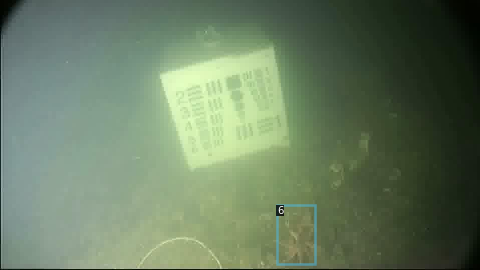

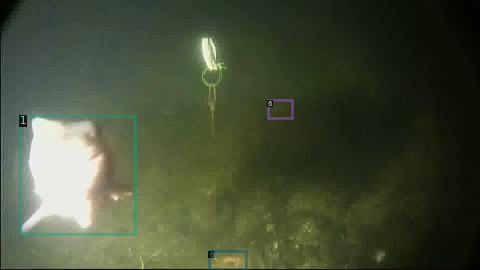

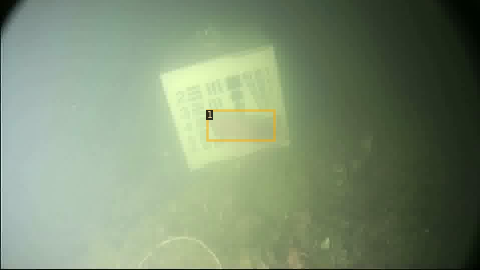

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [7]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [8]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_test",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 300 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 7 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()





[03/25 23:08:51 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/25 23:08:54 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x/139173657/model_final_68b088.pkl ...


model_final_68b088.pkl: 421MB [00:01, 216MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[03/25 23:08:59 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.9/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/25 23:10:48 d2.utils.events]:  eta: 0:23:25  iter: 19  total_loss: 2.924  loss_cls: 2.154  loss_box_reg: 0.4936  loss_rpn_cls: 0.2897  loss_rpn_loc: 0.0197    time: 5.0165  last_time: 5.1427  data_time: 0.0433  last_data_time: 0.0254   lr: 6.427e-05  max_mem: 10893M
[03/25 23:12:30 d2.utils.events]:  eta: 0:21:57  iter: 39  total_loss: 1.797  loss_cls: 0.9547  loss_box_reg: 0.622  loss_rpn_cls: 0.1449  loss_rpn_loc: 0.01859    time: 5.0581  last_time: 4.1339  data_time: 0.0261  last_data_time: 0.0269   lr: 0.00013087  max_mem: 10893M
[03/25 23:14:15 d2.utils.events]:  eta: 0:20:40  iter: 59  total_loss: 1.507  loss_cls: 0.7284  loss_box_reg: 0.6716  loss_rpn_cls: 0.09173  loss_rpn_loc: 0.01574    time: 5.1193  last_time: 5.3373  data_time: 0.0252  last_data_time: 0.0526   lr: 0.00019747  max_mem: 10893M
[03/25 23:15:59 d2.utils.events]:  eta: 0:19:07  iter: 79  total_loss: 1.602  loss_cls: 0.7759  loss_box_reg: 0.7376  loss_rpn_cls: 0.07377  loss_rpn_loc: 0.01394    time: 5.1424  l

/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/25 23:35:21 d2.evaluation.evaluator]: Inference done 11/1000. Dataloading: 0.0017 s/iter. Inference: 0.3100 s/iter. Eval: 0.0004 s/iter. Total: 0.3121 s/iter. ETA=0:05:08
[03/25 23:35:26 d2.evaluation.evaluator]: Inference done 27/1000. Dataloading: 0.0030 s/iter. Inference: 0.3088 s/iter. Eval: 0.0004 s/iter. Total: 0.3125 s/iter. ETA=0:05:04
[03/25 23:35:31 d2.evaluation.evaluator]: Inference done 43/1000. Dataloading: 0.0027 s/iter. Inference: 0.3105 s/iter. Eval: 0.0004 s/iter. Total: 0.3139 s/iter. ETA=0:05:00
[03/25 23:35:36 d2.evaluation.evaluator]: Inference done 58/1000. Dataloading: 0.0025 s/iter. Inference: 0.3116 s/iter. Eval: 0.0057 s/iter. Total: 0.3200 s/iter. ETA=0:05:01
[03/25 23:35:41 d2.evaluation.evaluator]: Inference done 74/1000. Dataloading: 0.0028 s/iter. Inference: 0.3126 s/iter. Eval: 0.0045 s/iter. Total: 0.3202 s/iter. ETA=0:04:56
[03/25 23:35:46 d2.evaluation.evaluator]: Inference done 90/1000. Dataloading: 0.0027 s/iter. Inference: 0.3136 s/iter. Eval:

In [9]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[03/25 23:40:38 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [03/25 23:40:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [03/25 23:40:39 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/25 23:40:39 d2.data.datasets.coco]: Loaded 1000 images in COCO format from /content/test/_annotations.coco.json
[03/25 23:40:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/25 23:40:39 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/25 23:40:39 d2.data.common]: Serializing 1000 elements to byte tensors and concatenating them all ...
[03/25 23:40:39 d2.data.common]: Serialized dataset ta

/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/25 23:40:43 d2.evaluation.evaluator]: Inference done 11/1000. Dataloading: 0.0027 s/iter. Inference: 0.3058 s/iter. Eval: 0.0004 s/iter. Total: 0.3088 s/iter. ETA=0:05:05
[03/25 23:40:48 d2.evaluation.evaluator]: Inference done 28/1000. Dataloading: 0.0027 s/iter. Inference: 0.3045 s/iter. Eval: 0.0003 s/iter. Total: 0.3077 s/iter. ETA=0:04:59
[03/25 23:40:53 d2.evaluation.evaluator]: Inference done 44/1000. Dataloading: 0.0040 s/iter. Inference: 0.3066 s/iter. Eval: 0.0004 s/iter. Total: 0.3112 s/iter. ETA=0:04:57
[03/25 23:40:59 d2.evaluation.evaluator]: Inference done 60/1000. Dataloading: 0.0036 s/iter. Inference: 0.3089 s/iter. Eval: 0.0004 s/iter. Total: 0.3131 s/iter. ETA=0:04:54
[03/25 23:41:04 d2.evaluation.evaluator]: Inference done 76/1000. Dataloading: 0.0037 s/iter. Inference: 0.3114 s/iter. Eval: 0.0004 s/iter. Total: 0.3156 s/iter. ETA=0:04:51
[03/25 23:41:09 d2.evaluation.evaluator]: Inference done 92/1000. Dataloading: 0.0038 s/iter. Inference: 0.3127 s/iter. Eval:

OrderedDict([('bbox',
              {'AP': 20.382573439895086,
               'AP50': 43.314198954484155,
               'AP75': 15.156439013864157,
               'APs': 11.34269940217999,
               'APm': 20.280054972121068,
               'APl': 23.167229950594074,
               'AP-maritime-data': nan,
               'AP-1': 28.817137389612107,
               'AP-2': 14.593469756494587,
               'AP-3': 8.605525486676635,
               'AP-4': 3.879833363623663,
               'AP-5': 25.717167699578297,
               'AP-6': 40.68230694338521})])

# Inference with Detectron2 Saved Weights



In [15]:
os.system("ls output")

0

In [16]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[03/25 23:52:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


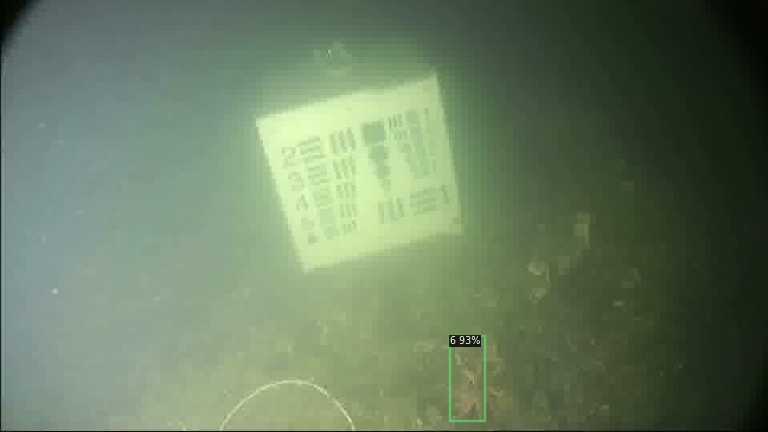

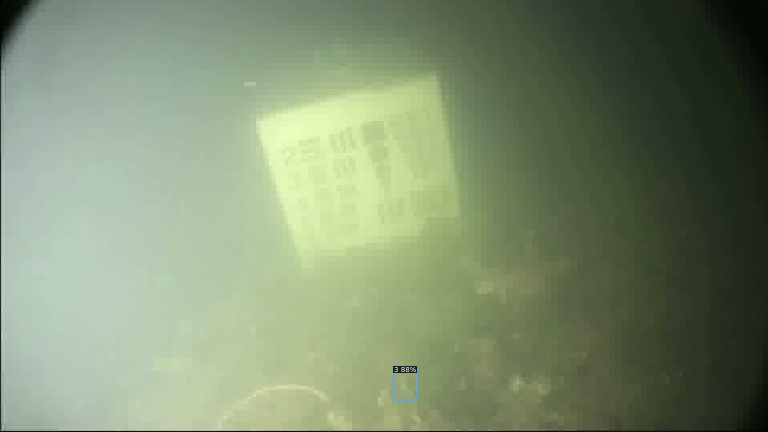

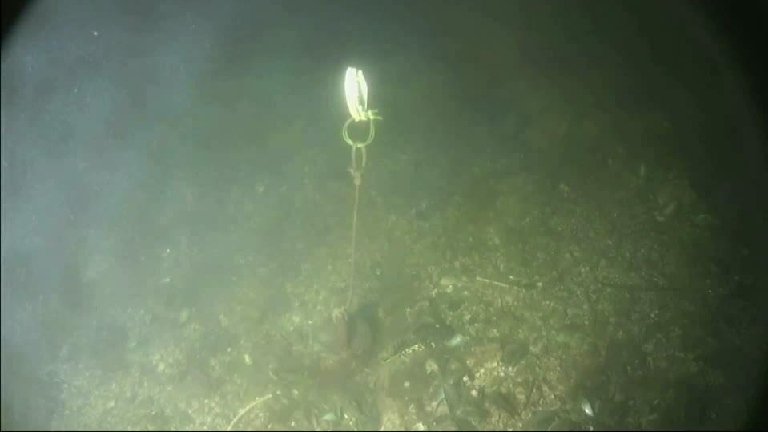

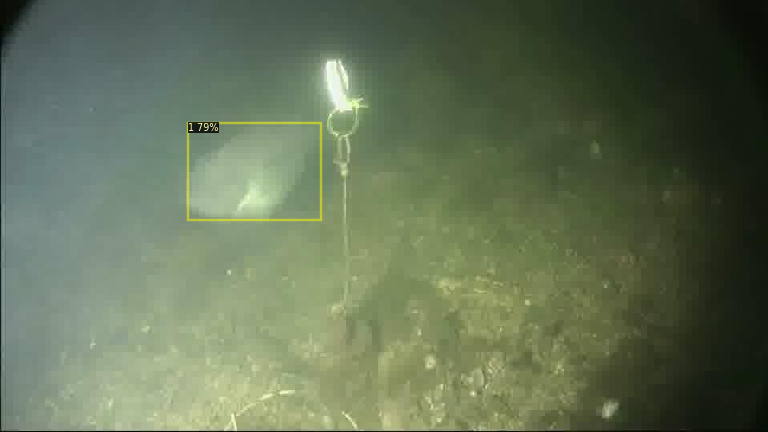

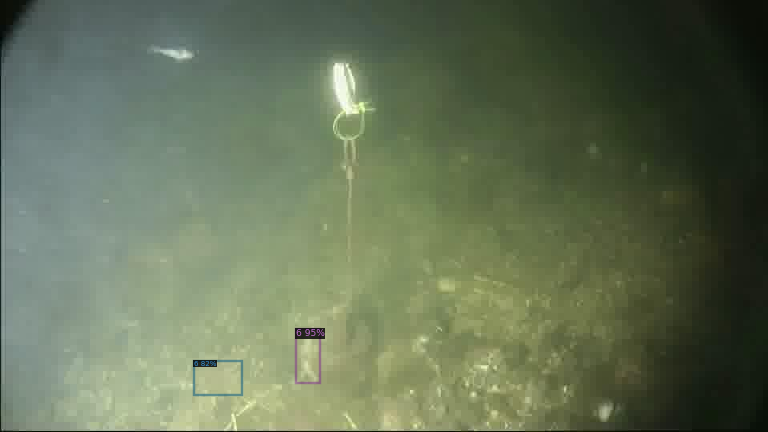

...

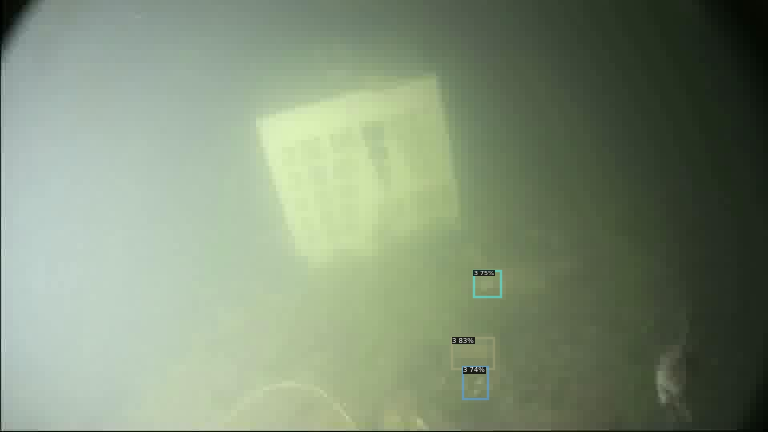

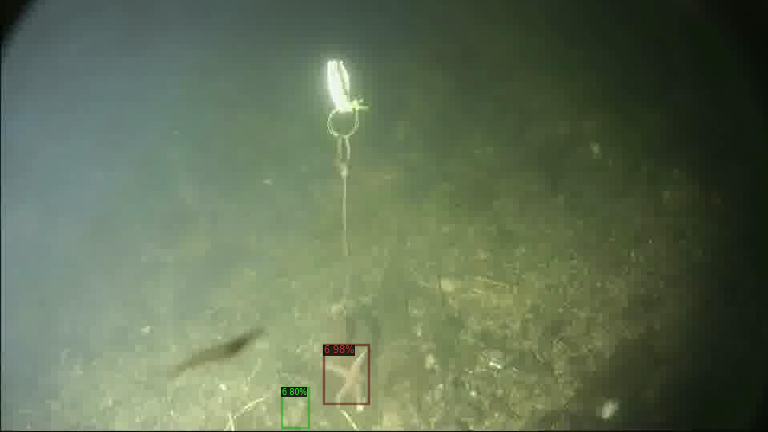

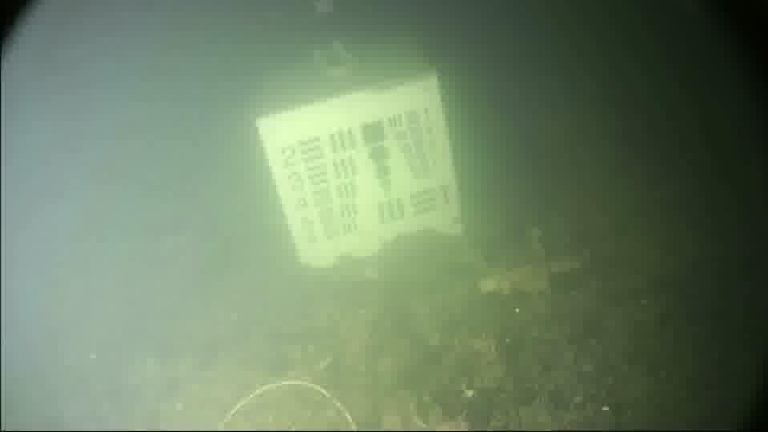

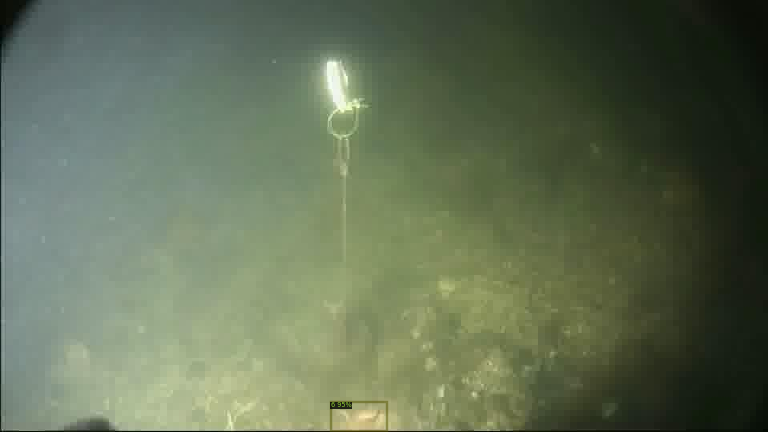

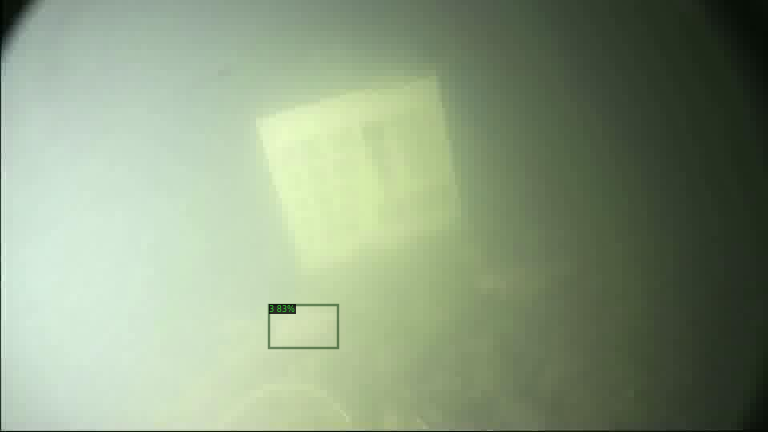

KeyboardInterrupt: ignored

In [17]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


In [19]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>